<b><h2> Computer Vision Project</h2></b>
<i><h3> Road Extraction from RoadNet-based Satellite Imagery Using Classical Computer Vision Techniques</h3></i>
<h4> Team Members: Allister KOHN, Enzo PALOS, Emma SCHAPIRA</h4>

### Imports

In [2]:
import os
import cv2
import numpy as np
import gdown
import zipfile
import matplotlib.pyplot as plt
from skimage.morphology import skeletonize
from skimage import data, io, filters, morphology, img_as_ubyte

### Dataset Downloading

In [4]:
os.makedirs("../Datas", exist_ok=True)

url = "https://drive.google.com/uc?id=1GDHy7uwgOswuCDC49OamlNkAxjaITPBI&confirm=t&uuid=35d15d67-4592-4723-9b57-2c5256af8e62"

output = "../Datas/Ottawa-Dataset.zip"
gdown.download(url, output, quiet=False)

with zipfile.ZipFile("../Datas/Ottawa-Dataset.zip", "r") as zip_ref:
    zip_ref.extractall("../Datas/Ottawa-Dataset")

Downloading...
From: https://drive.google.com/uc?id=1GDHy7uwgOswuCDC49OamlNkAxjaITPBI&confirm=t&uuid=35d15d67-4592-4723-9b57-2c5256af8e62
To: /Users/allisterkohn/Desktop/CV-Project/Datas/Ottawa-Dataset.zip
100%|██████████| 949M/949M [00:53<00:00, 17.6MB/s]


### Image Loading

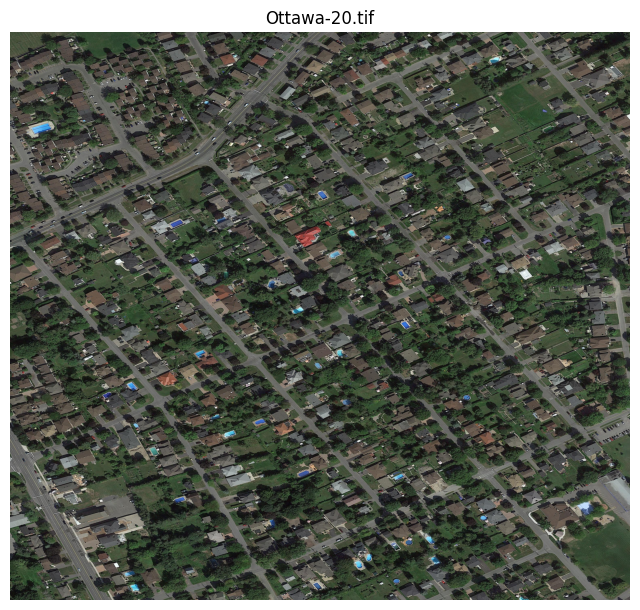

In [ ]:
nb = 20
image_path = f'../Datas/Ottawa-Dataset/{nb}/Ottawa-{nb}.tif'

image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # Convertir en RGB
image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV) # Convertir en HSV
if image is None:
	print("Erreur")
	exit()
else:
	plt.figure(figsize=(8, 8))
	plt.imshow(image_rgb)
	plt.title(image_path.split("/")[-1])
	plt.axis('off')
	plt.show()

### Histograms

In [17]:
def plot_histogram_rgb(image, title="RGB Histogram"):
	colors = ('blue', 'green', 'red')
	plt.figure(figsize=(8, 5))
	
	for i, color in enumerate(colors):
		hist = cv2.calcHist([image], [i], None, [256], [0, 256])
		plt.plot(hist, color=color, label=f'{color.capitalize()} Channel')
	
	plt.title(title)
	plt.xlabel('Pixel Intensity')
	plt.ylabel('Frequency')
	plt.xlim([0, 256])
	plt.legend()
	plt.show()

In [18]:
def plot_histogram_grayscale(image, title="Histogram"):
	hist = cv2.calcHist([image], [0], None, [256], [0, 256])
	plt.figure(figsize=(8, 5))
	plt.plot(hist, color='black')
	plt.title(title)
	plt.xlabel('Grayscale')
	plt.ylabel('Frequency')
	plt.xlim([0, 256])
	plt.show()

### White balancing

Blue: 69.89 	Green: 74.81 	Red: 63.88
Blue: 68.9 	Green: 69.03 	Red: 69.01


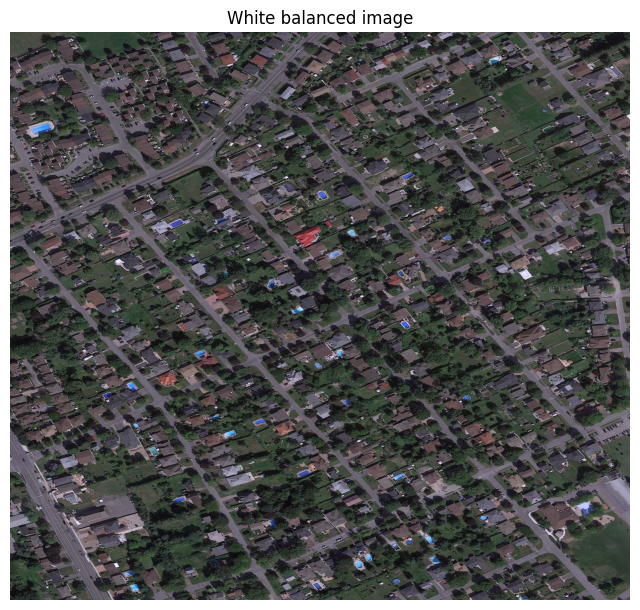

In [ ]:
def white_balance_gray_world(image):
    result = image.copy()
    
    # Compute the mean of each channel
    mean_b = np.mean(image[:, :, 0])
    mean_g = np.mean(image[:, :, 1])
    mean_r = np.mean(image[:, :, 2])
    print("Blue:", round(mean_b, 2),
          "\tGreen:", round(mean_g, 2),
          "\tRed:", round(mean_r, 2))
    
    # Compute the adjustment factor
    mean_gray = (mean_b + mean_g + mean_r) / 3
    scale_b = mean_gray / mean_b
    scale_g = mean_gray / mean_g
    scale_r = mean_gray / mean_r

    # Apply the correction to each channel
    result[:, :, 0] = np.clip(image[:, :, 0] * scale_b, 0, 255)
    result[:, :, 1] = np.clip(image[:, :, 1] * scale_g, 0, 255)
    result[:, :, 2] = np.clip(image[:, :, 2] * scale_r, 0, 255)

    # Print the new mean values
    print("Blue:", round(np.mean(result[:, :, 0]), 2),
          "\tGreen:", round(np.mean(result[:, :, 1]), 2),
          "\tRed:", round(np.mean(result[:, :, 2]), 2))

    return result.astype(np.uint8)

# Apply white balance
white_balanced_image = white_balance_gray_world(image_rgb)

plt.figure(figsize=(8, 8))
plt.imshow(white_balanced_image)
plt.title("White Balanced Image")
plt.axis('off')
plt.show()

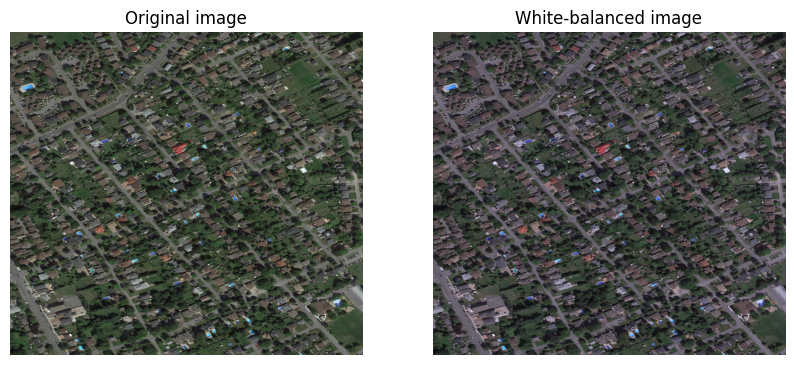

In [20]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(image_rgb)
plt.title("Original image")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(white_balanced_image)
plt.title("White-balanced image")
plt.axis('off')
plt.show()

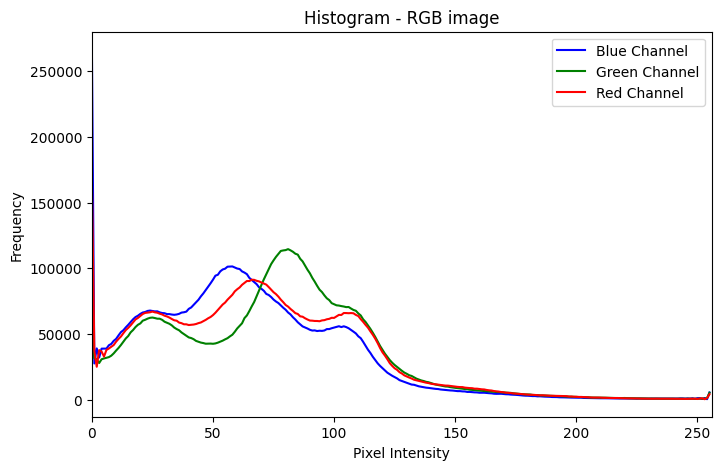

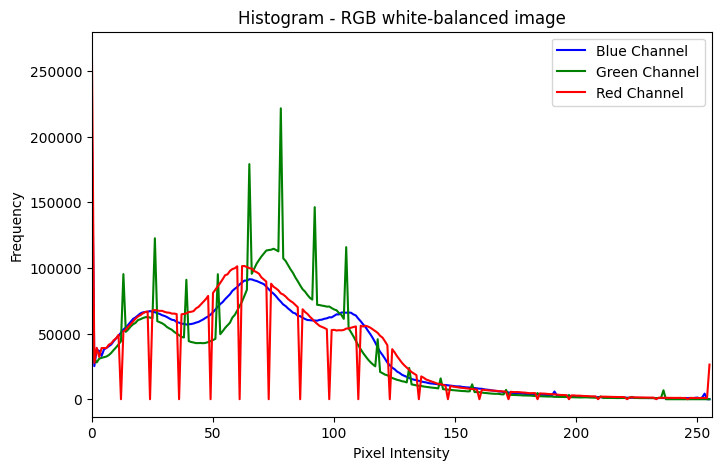

In [21]:
plot_histogram_rgb(image, title="Histogram - RGB image")
plot_histogram_rgb(white_balanced_image, title="Histogram - RGB white-balanced image")

### Grayscale

#### Grayscale on the original image

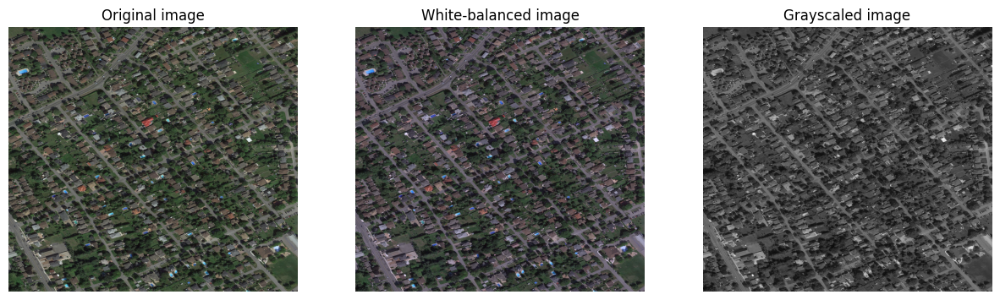

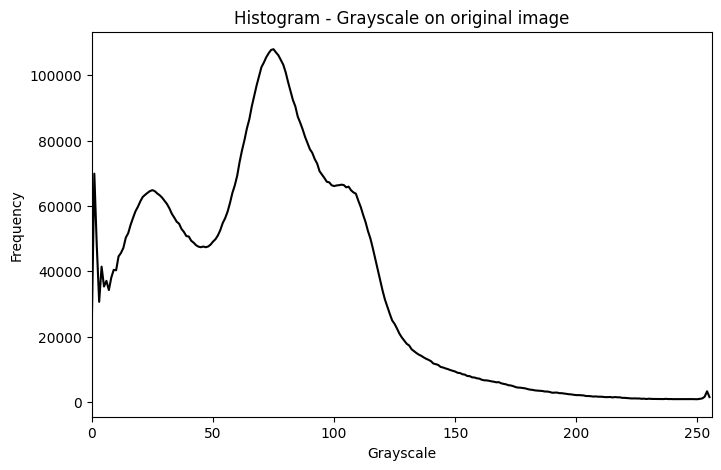

In [22]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(15,5))
plt.subplot(1,3,1)
plt.imshow(image_rgb)
plt.title("Original image")
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow(white_balanced_image)
plt.title("White-balanced image")
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(gray, cmap='gray')
plt.title("Grayscaled image")
plt.axis('off')
plt.show()

# plot_histogram_rgb(image, title="Histogram - RGB image")
plot_histogram_grayscale(gray, title="Histogram - Grayscale on original image")

#### Grayscale on the white balanced image

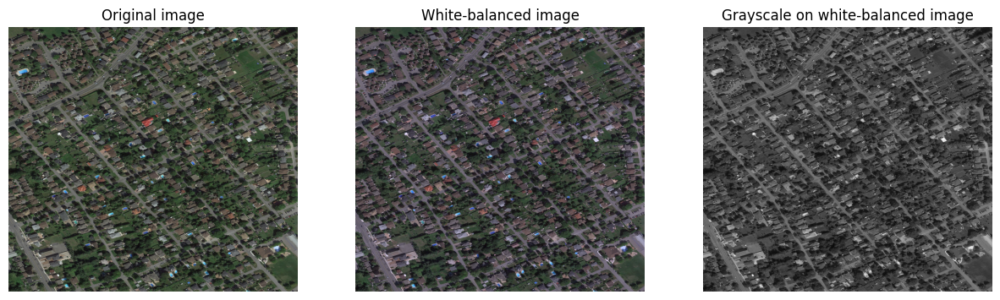

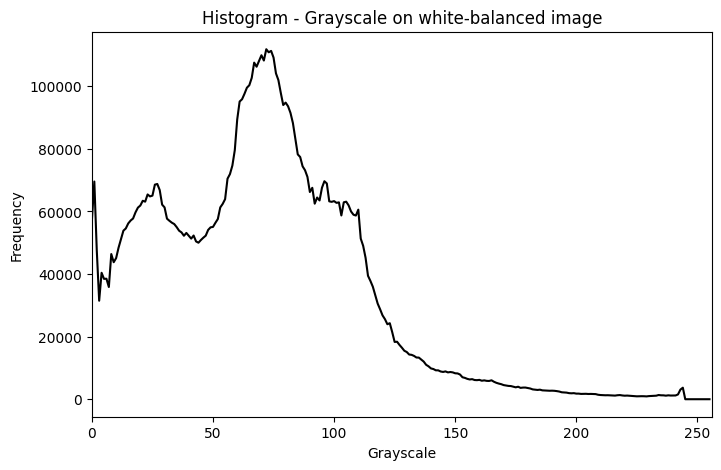

In [23]:
gray = cv2.cvtColor(white_balanced_image, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(15,5))
plt.subplot(1,3,1)
plt.imshow(image_rgb)
plt.title("Original image")
plt.axis('off')

plt.subplot(1,3,2)
plt.imshow(white_balanced_image)
plt.title("White-balanced image")
plt.axis('off')

plt.subplot(1,3,3)
plt.imshow(gray, cmap='gray')
plt.title("Grayscale on white-balanced image")
plt.axis('off')
plt.show()

#plot_histogram_rgb(image, title="Histogram - RGB image")
plot_histogram_grayscale(gray, title="Histogram - Grayscale on white-balanced image")

### Histogram Equalization

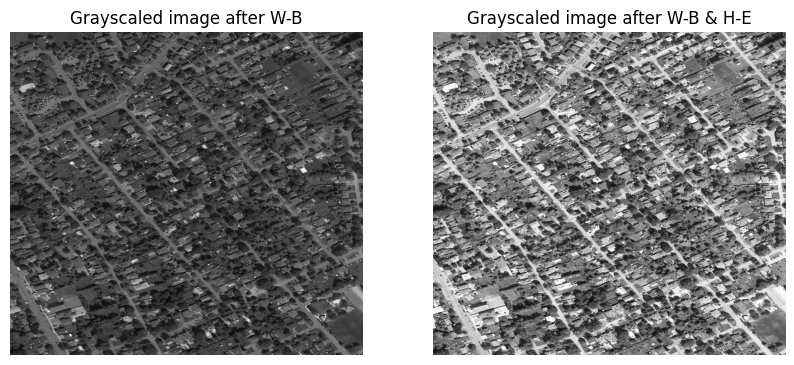

In [24]:
gray_eq = cv2.equalizeHist(gray)

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(gray, cmap='gray')
plt.title("Grayscaled image after W-B")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(gray_eq, cmap='gray')
plt.title("Grayscaled image after W-B & H-E")
plt.axis('off')
plt.show()

### Anisotropic Diffusion

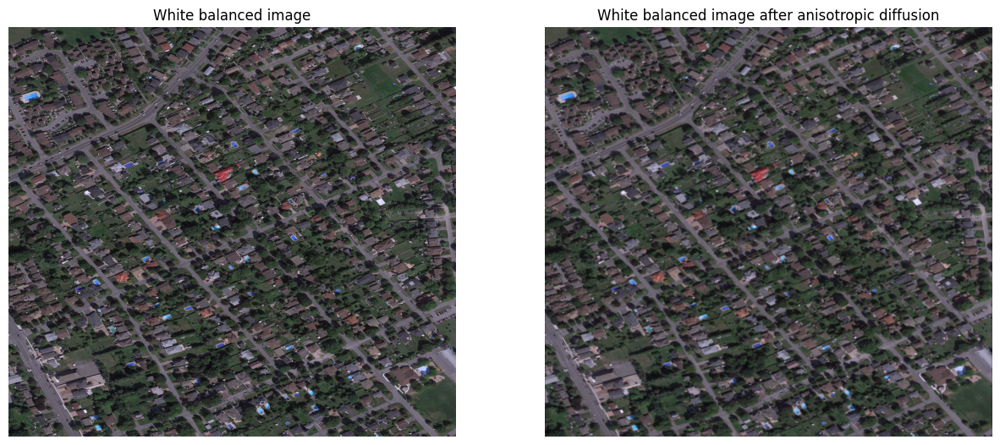

In [ ]:
num_iterations = 10  # Number of iterations
lambda_param = 0.1  # Conduction factor
kappa = 50  # Edge sensitivity

filtered_image = cv2.ximgproc.anisotropicDiffusion(white_balanced_image, 
                                                   alpha=lambda_param, 
                                                   K=kappa, 
                                                   niters=num_iterations)

# Display the original and filtered images
plt.figure(figsize=(15, 15))
plt.subplot(1, 2, 1)
plt.imshow(white_balanced_image, cmap="gray")
plt.axis('off')
plt.title("White Balanced Image")
plt.subplot(1, 2, 2)
plt.imshow(filtered_image, cmap="gray")
plt.axis('off')
plt.title("White Balanced Image After Anisotropic Diffusion")
plt.show()

### Median Filter

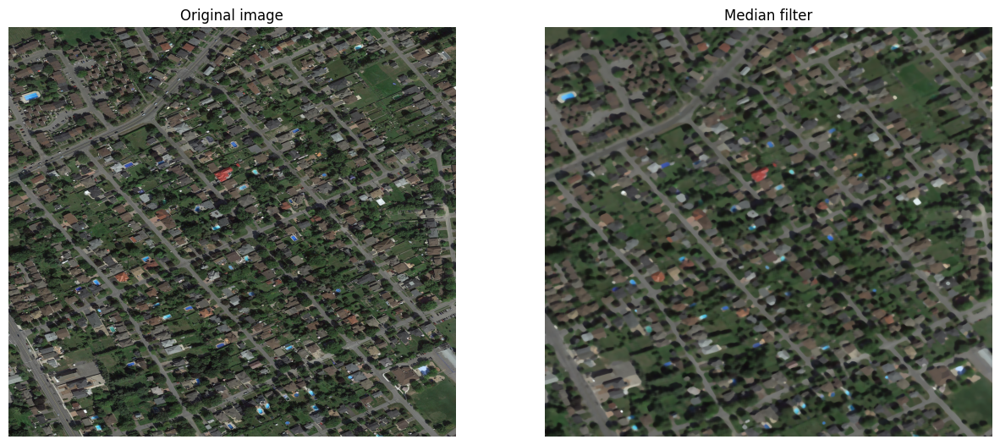

In [26]:
kernel_size = 23
median_blurred = cv2.medianBlur(image_rgb, kernel_size)

plt.figure(figsize=(15,15))

plt.subplot(1,2,1)
plt.imshow(image_rgb)
plt.axis('off')
plt.title("Original image")

plt.subplot(1,2,2)
plt.imshow(median_blurred)
plt.axis('off')
plt.title("Median filter")

plt.show()

### Bilateral Filter

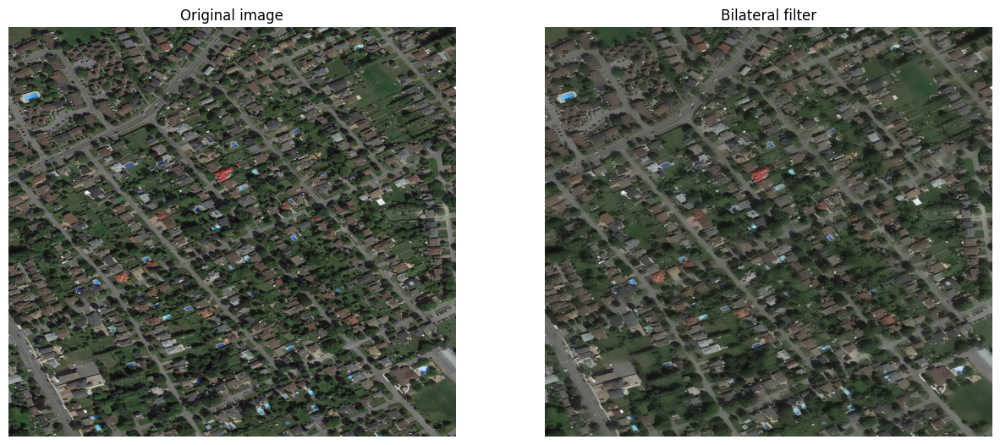

In [27]:
param = 0
bilateral_filtered = cv2.bilateralFilter(image_rgb, 67, 75, 75)

plt.figure(figsize=(15,15))

plt.subplot(1,2,1)
plt.imshow(image_rgb)
plt.axis('off')
plt.title("Original image")

plt.subplot(1,2,2)
plt.imshow(bilateral_filtered)
plt.axis('off')
plt.title("Bilateral filter")

plt.show()

### Comparaison between the Median and Bilateral Filter

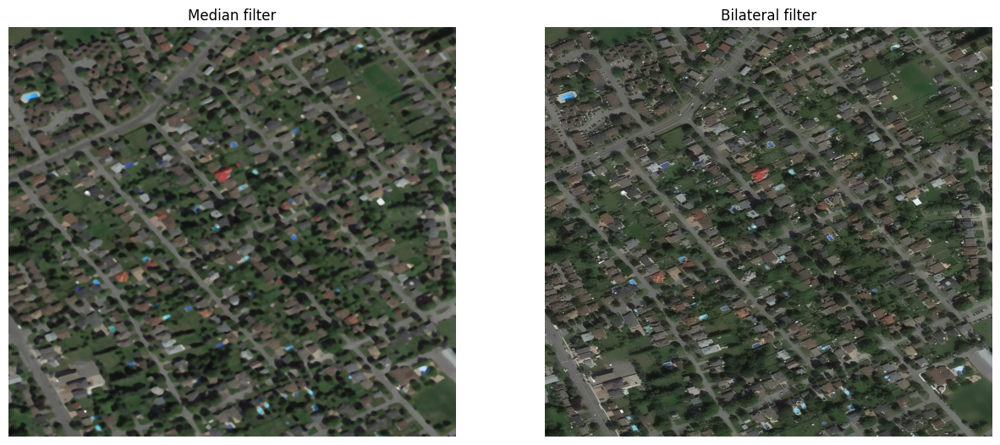

In [28]:
plt.figure(figsize=(15,15))

plt.subplot(1,2,1)
plt.imshow(median_blurred, cmap='gray')
plt.title("Median filter")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(bilateral_filtered, cmap='gray')
plt.title("Bilateral filter")
plt.axis('off')

plt.show()

As we can see with the comparision, the median filter removes noise by replacing each pixel with the median of its neighbors, making it effective for salt-and-pepper noise while preserving edges. The bilateral filter, however, smooths while considering both spatial proximity and intensity similarity, reducing noise without blurring edges. Unlike the median filter, it better preserves fine details and textures.

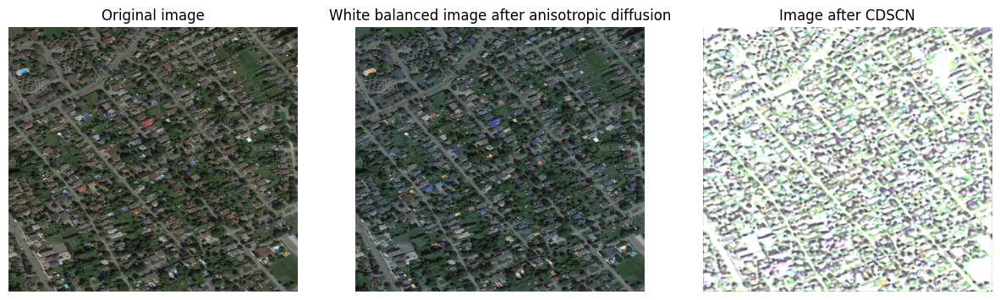

In [ ]:
def cds_contrast_normalization(image, kernel_size=7, alpha=1.0, beta=0.5):
    # Convert to float to avoid calculation errors
    image = image.astype(np.float32)

    # Compute local mean
    mean_local = cv2.blur(image, (kernel_size, kernel_size))

    # Compute local standard deviation
    sqr_image = image ** 2
    mean_sqr_local = cv2.blur(sqr_image, (kernel_size, kernel_size))
    # Avoid division by zero
    std_local = np.sqrt(np.maximum(mean_sqr_local - mean_local**2, 1e-6))

    # Bidirectional normalization
    normalized_image = (image - beta * mean_local) / (alpha * std_local + 1e-6)

    # Re-normalize values to stay within a visible range (0-255)
    normalized_image = np.clip(normalized_image * 128 + 128, 0, 255)

    return normalized_image.astype(np.uint8)


# Apply CDSCN
normalized_image = cds_contrast_normalization(
    filtered_image, kernel_size=55, alpha=1.5, beta=0.7)
normalized_image = cv2.medianBlur(normalized_image, 23)
normalized_image = cv2.GaussianBlur(normalized_image, (3, 3), 0)

# Display results
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(image_rgb, cmap="gray")
plt.title("Original Image")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(image, cmap="gray")
plt.title("White Balanced Image After Anisotropic Diffusion")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(normalized_image, cmap="gray")
plt.title("Image After CDSCN")
plt.axis('off')

plt.show()

### Grey Mask

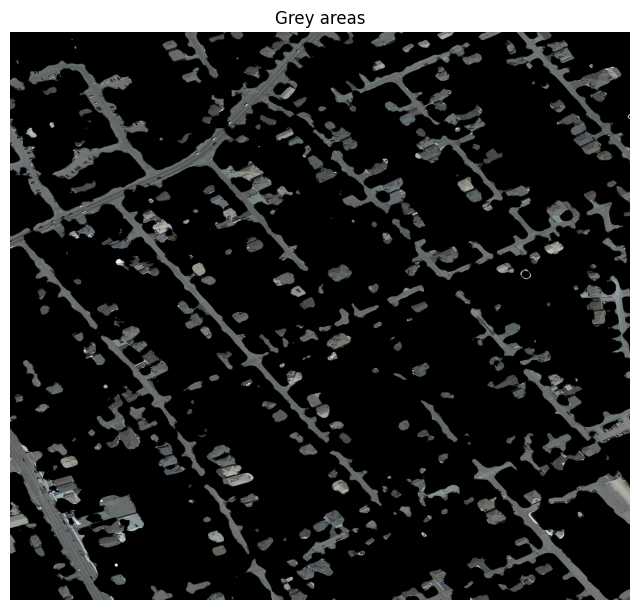

In [30]:
lower_gray = np.array([0, 0, 70])
upper_gray = np.array([300, 30, 220])

kernel_size = 31
median_blurred = cv2.medianBlur(image_hsv, kernel_size)

mask_gray = cv2.inRange(median_blurred, lower_gray, upper_gray)

kernel = np.ones((5, 5), np.uint8)
mask_closed = cv2.morphologyEx(mask_gray, cv2.MORPH_CLOSE, kernel)

result = cv2.bitwise_and(image, image, mask=mask_closed)

plt.figure(figsize=(8, 8))
plt.imshow(result, cmap='gray')
plt.title("Grey areas")
plt.axis("off")
plt.show()

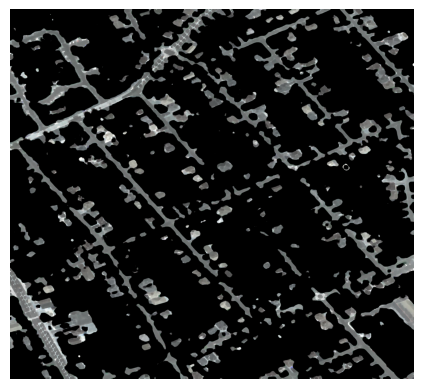

In [31]:
kernel_size = 13
iterations = 1
kernel = np.ones((kernel_size, kernel_size), np.uint8)
closed_image = cv2.morphologyEx(result, cv2.MORPH_CLOSE, kernel, iterations=iterations)
plt.imshow(closed_image)
plt.axis('off')
plt.show()

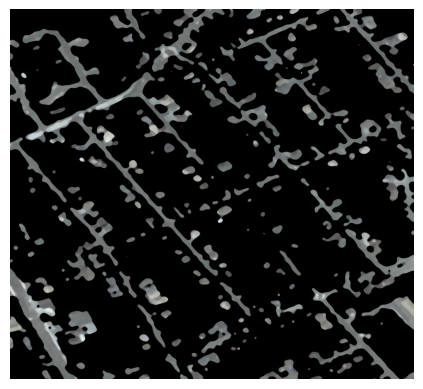

In [32]:
kernel_size = 31
median_blurred2 = cv2.medianBlur(closed_image, kernel_size)

plt.imshow(median_blurred2)
plt.axis('off')
plt.show()

### Mask to preserve green areas

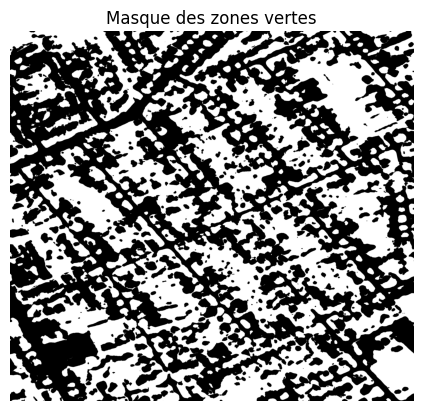

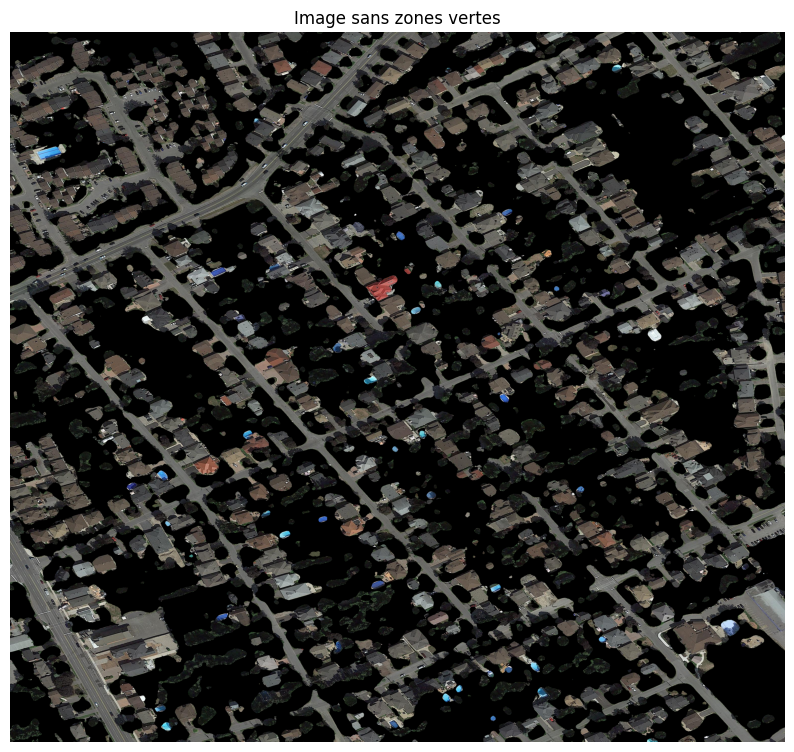

In [ ]:
image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

# Define thresholds for green color in HSV
lower_green = np.array([35, 40, 40])  # Minimum values
upper_green = np.array([85, 255, 255])  # Maximum values

# Create the vegetation (green) mask
kernel_size = 31
median_blurred = cv2.medianBlur(image_hsv, kernel_size)
mask_green = cv2.inRange(median_blurred, lower_green, upper_green)

# Display the mask
plt.imshow(mask_green, cmap='gray')
plt.title("Green Areas Mask")
plt.axis("off")
#plt.show()

# Remove green areas from the image --
image_no_green = cv2.bitwise_and(image, image, mask=cv2.bitwise_not(mask_green))

# Convert for display
image_no_green_rgb = cv2.cvtColor(image_no_green, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10, 10))
plt.imshow(image_no_green_rgb)
plt.title("Image Without Green Areas")
plt.axis("off")
plt.show()

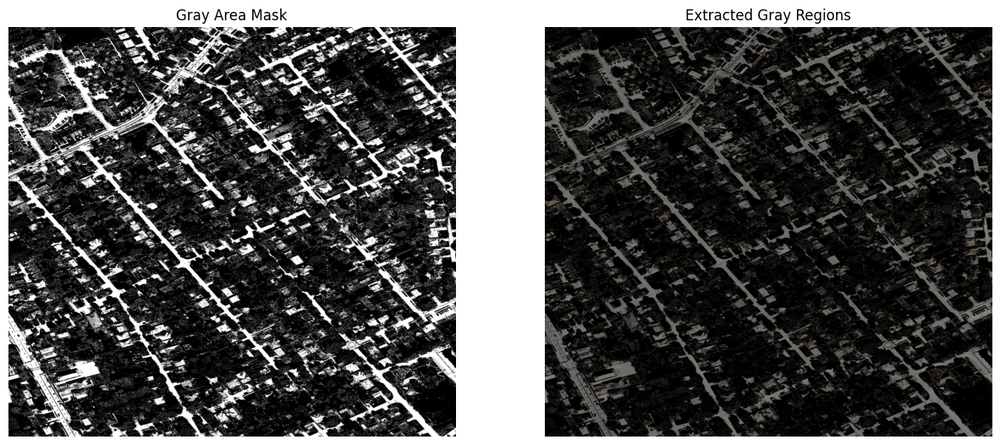

Range: 80 - 140


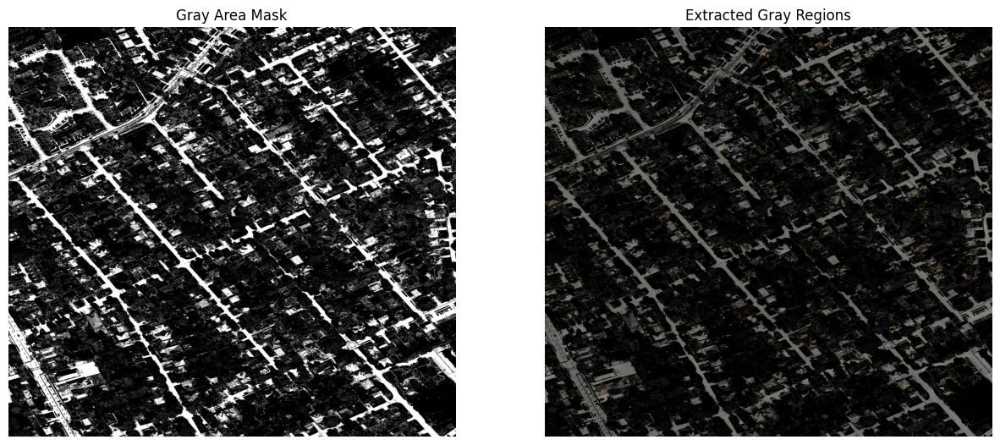

Range: 85 - 145


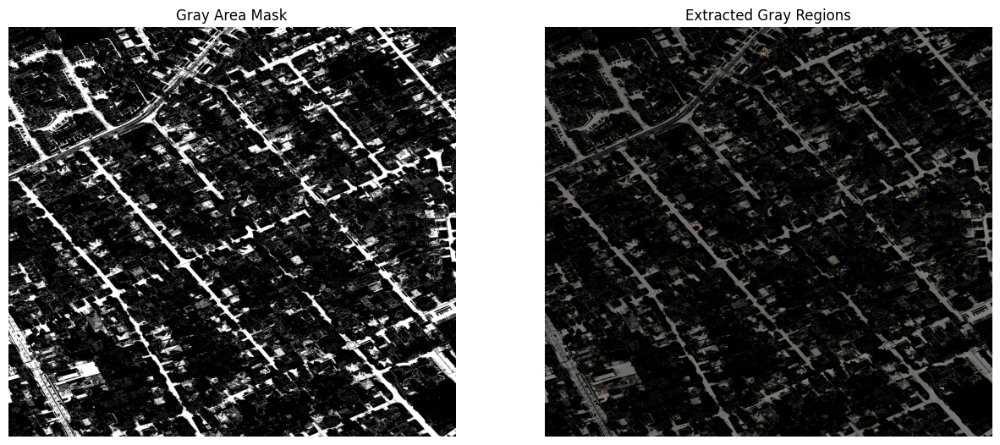

Range: 90 - 150


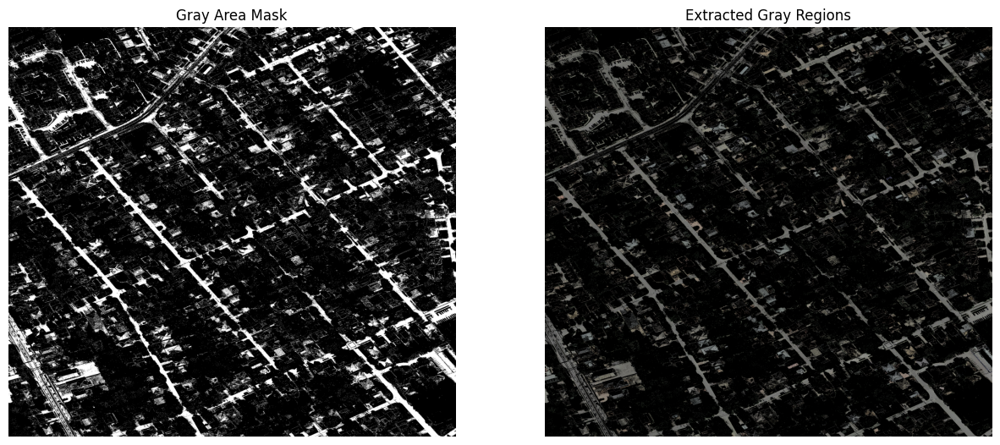

Range: 95 - 155


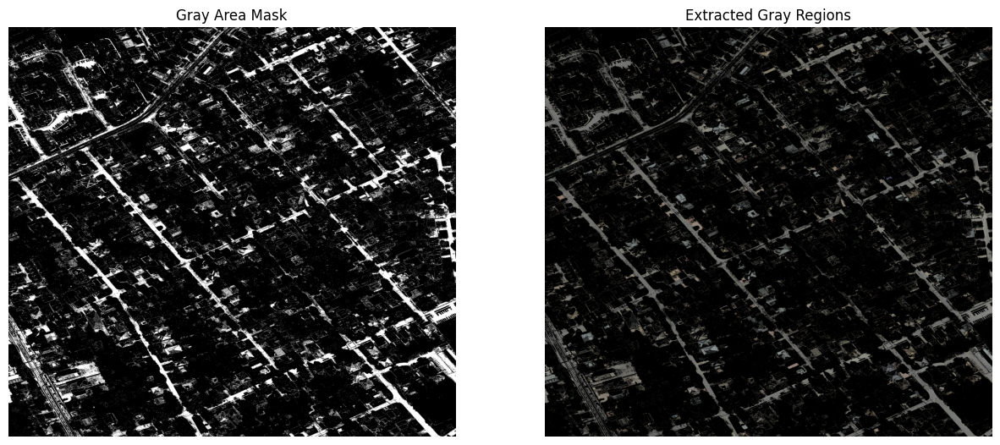

Range: 100 - 160


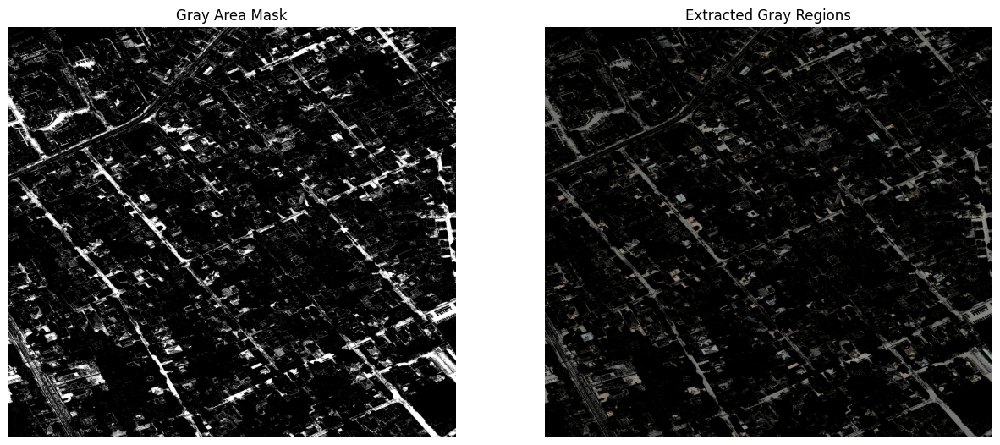

Range: 105 - 165


In [34]:
image_hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
image_hsv = cv2.medianBlur(image_hsv, 7)

for i in range(80, 110, 5):
	lower_grey = np.array([i, i, i], dtype=np.uint8)
	upper_grey = np.array([i+60, i+60, i+60], dtype=np.uint8)  

	mask = cv2.inRange(image, lower_grey, upper_grey)

	result = cv2.bitwise_and(image, image, mask=mask)

	plt.figure(figsize=(15,8))

	# plt.subplot(1,2,1)
	# plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
	# plt.title("Image originale")
	# plt.axis('off')

	plt.subplot(1,2,1)
	plt.imshow(mask, cmap="gray")
	plt.title("Gray Area Mask")
	plt.axis('off')

	plt.subplot(1,2,2)
	plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
	plt.title("Extracted Gray Regions")
	plt.axis('off')

	plt.show()
	print("Range:", i, "-", i+60)

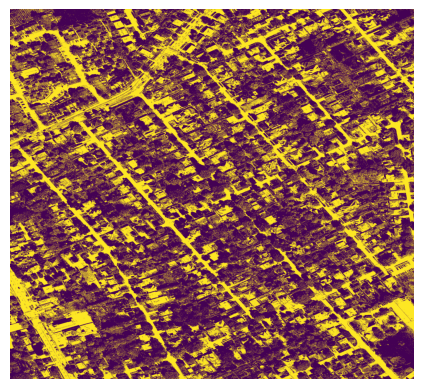

In [35]:
img = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

_ , img = cv2.threshold(img,80,255,cv2.THRESH_BINARY)
plt.imshow(img)
plt.axis('off')
plt.show()

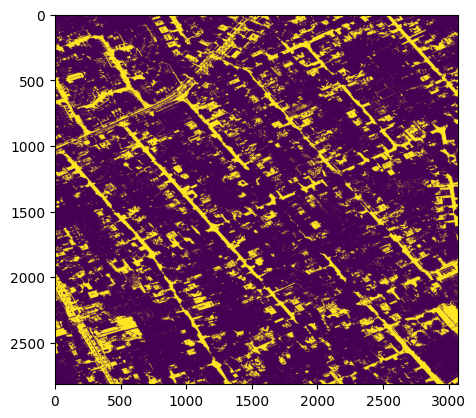

In [36]:
img = morphology.binary_erosion(img,morphology.diamond(1))
img = img_as_ubyte(img)
plt.imshow(img)
plt.show()

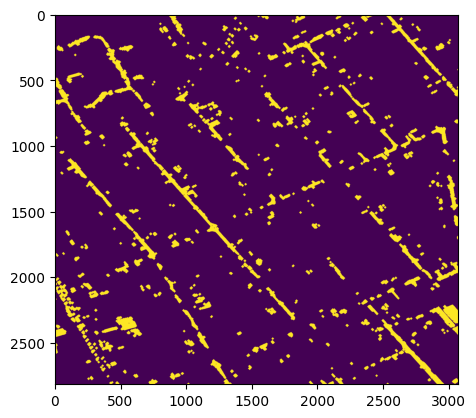

In [37]:
element = cv2.getStructuringElement(cv2.MORPH_CROSS, (3,3))
img = cv2.erode(img, element, iterations =10)
img = cv2.dilate(img, element, iterations =10)
plt.imshow(img)
plt.show()

### CLAHE

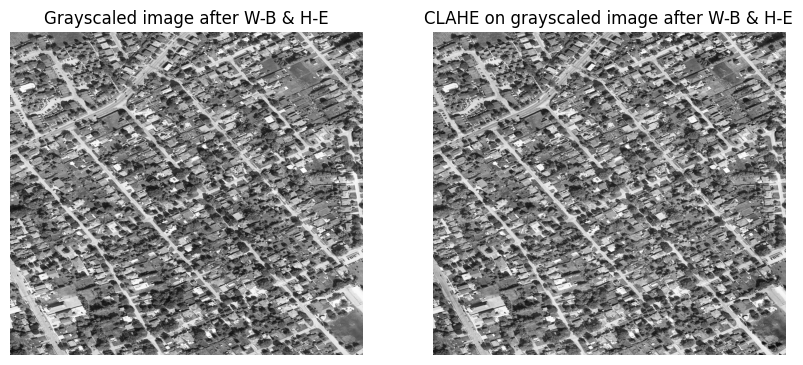

In [38]:
clahe = cv2.createCLAHE(clipLimit=20, tileGridSize=(8,8))
clahe_img = clahe.apply(gray_eq)

plt.figure(figsize=(10,5))

plt.subplot(1,2,1)
plt.imshow(gray_eq, cmap='gray')
plt.title("Grayscaled image after W-B & H-E")
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(clahe_img, cmap='gray')
plt.title("CLAHE on grayscaled image after W-B & H-E")
plt.axis('off')

plt.show()

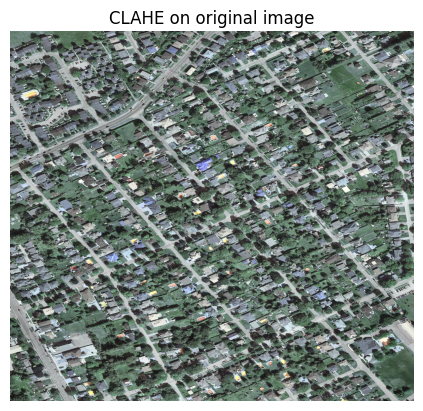

In [39]:
lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
l, a, b = cv2.split(lab)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
l_clahe = clahe.apply(l)
lab_clahe = cv2.merge((l_clahe, a, b))
image_clahe = cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2BGR)

plt.imshow(image_clahe)
plt.axis('off')
plt.title("CLAHE on original image")
plt.show()

In [40]:
# blurred = cv2.GaussianBlur(clahe_img, (19,19), 0)

# plt.figure(figsize=(8,8))
# plt.imshow(blurred, cmap='gray')
# plt.title("Gaussian Blur")
# plt.axis('off')

### SOBEL

In [41]:
# sobelx = cv2.Sobel(blurred, cv2.CV_64F, 1, 0, ksize=3)
# sobely = cv2.Sobel(blurred, cv2.CV_64F, 0, 1, ksize=3)
# sobel_mag = cv2.magnitude(sobelx, sobely)
# sobel_mag = np.uint8(sobel_mag)

# _, sobel_bin = cv2.threshold(sobel_mag, 50, 255, cv2.THRESH_BINARY)

# kernel = np.ones((9,9), np.uint8)
# sobel_clean = cv2.morphologyEx(sobel_bin, cv2.MORPH_CLOSE, kernel)

# plt.figure(figsize=(15,5))

# plt.subplot(1,3,1)
# plt.imshow(sobelx, cmap='gray')
# plt.title("Sobel X")
# plt.axis('off')

# plt.subplot(1,3,2)
# plt.imshow(sobely, cmap='gray')
# plt.title("Sobel Y")
# plt.axis('off')

# plt.subplot(1,3,3)
# plt.imshow(sobel_clean, cmap='gray')
# plt.title("Sobel Binarisé + Morphologie")
# plt.axis('off')

# plt.show()

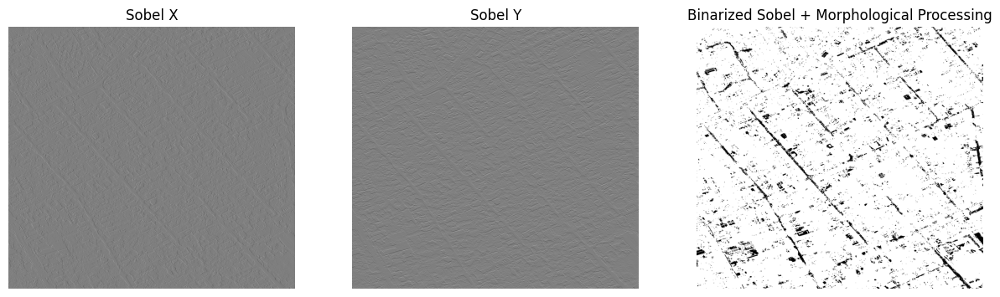

In [ ]:
# Compute Sobel gradients
sobelx = cv2.Sobel(clahe_img, cv2.CV_64F, 1, 0, ksize=3)
sobely = cv2.Sobel(clahe_img, cv2.CV_64F, 0, 1, ksize=3)
sobel_mag = cv2.magnitude(sobelx, sobely)
sobel_mag = np.uint8(sobel_mag)

# Binary thresholding
_, sobel_bin = cv2.threshold(sobel_mag, 50, 255, cv2.THRESH_BINARY)

# Morphological closing to fill potential discontinuities
kernel = np.ones((3,3), np.uint8)
sobel_clean = cv2.morphologyEx(sobel_bin, cv2.MORPH_CLOSE, kernel)

# Display results
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(sobelx, cmap='gray')
plt.title("Sobel X")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(sobely, cmap='gray')
plt.title("Sobel Y")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(sobel_clean, cmap='gray')
plt.title("Binarized Sobel + Morphological Processing")
plt.axis('off')

plt.show()

### Canny

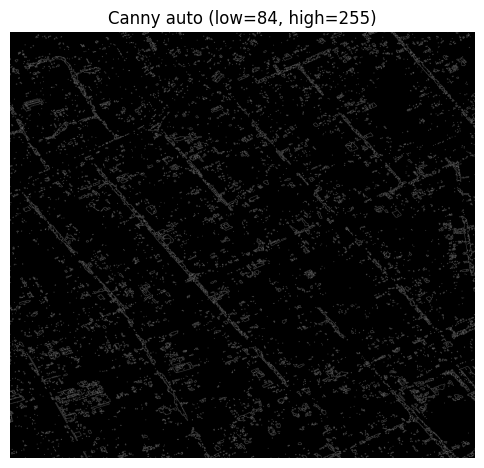

In [43]:
median_val = np.median(sobel_clean)
low = int(max(0, 0.33 * median_val))
high = int(min(255, 1.33 * median_val))

edges = cv2.Canny(sobel_clean, low, high)

plt.figure(figsize=(6,6))
plt.imshow(edges, cmap='gray')
plt.title(f"Canny auto (low={low}, high={high})")
plt.axis('off')
plt.show()

### Canny with anisotropic filtering

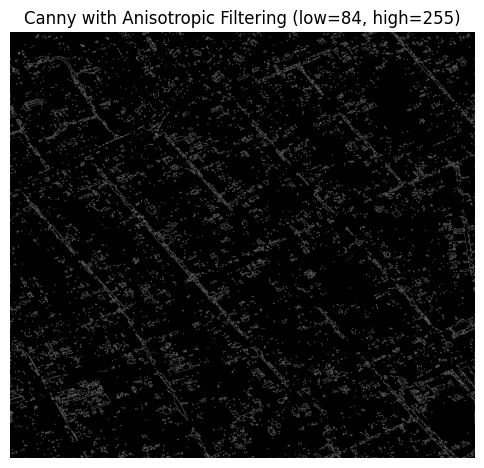

In [ ]:
# Apply anisotropic filtering to smooth while preserving edges
def anisotropic_filter(image, alpha=0.1, K=30, niters=10):
    filtered = image.astype(np.float32) / 255.0  # Normalize between 0 and 1
    for _ in range(niters):
        grad_n = np.roll(filtered, -1, axis=0) - filtered
        grad_s = np.roll(filtered, 1, axis=0) - filtered
        grad_e = np.roll(filtered, -1, axis=1) - filtered
        grad_w = np.roll(filtered, 1, axis=1) - filtered

        c_n = np.exp(-(grad_n / K) ** 2)
        c_s = np.exp(-(grad_s / K) ** 2)
        c_e = np.exp(-(grad_e / K) ** 2)
        c_w = np.exp(-(grad_w / K) ** 2)

        filtered += alpha * (c_n * grad_n + c_s * grad_s + c_e * grad_e + c_w * grad_w)

    return (filtered * 255).astype(np.uint8)  # Re-normalization

# Apply anisotropic filtering
filtered_image = anisotropic_filter(sobel_clean, alpha=0.05, K=50, niters=20)

# Compute median value for thresholding
median_val = np.median(filtered_image)
low = int(max(0, 0.33 * median_val))
high = int(min(255, 1.33 * median_val))

# Apply Canny edge detection
edges_with = cv2.Canny(filtered_image, low, high)

# Display results
plt.figure(figsize=(6, 6))
plt.imshow(edges_with, cmap='gray')
plt.title(f"Canny with Anisotropic Filtering (low={low}, high={high})")
plt.axis('off')
plt.show()

### Comparison between Canny with and without anisotropic filtering

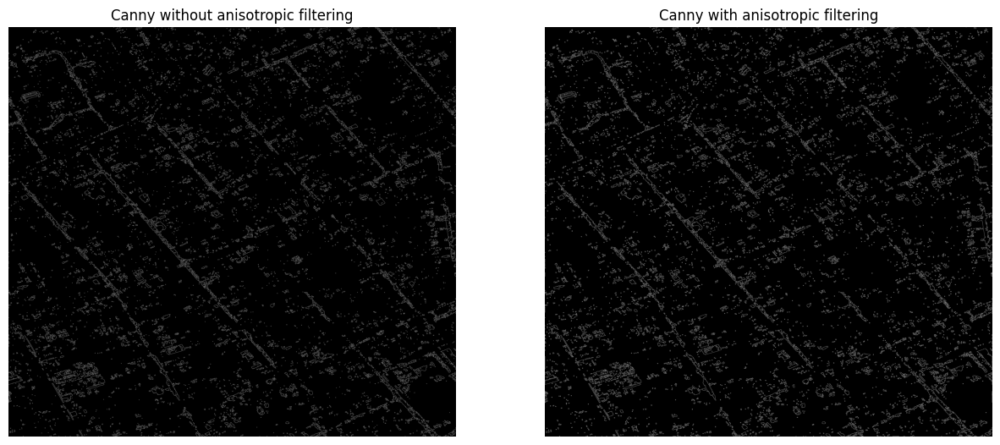

In [ ]:
plt.figure(figsize=(15, 15))

plt.subplot(1, 2, 1)
plt.imshow(edges, cmap='gray')
plt.title("Canny without anisotropic filtering")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(edges_with, cmap='gray')
plt.title("Canny with anisotropic filtering")
plt.axis('off')

plt.show()

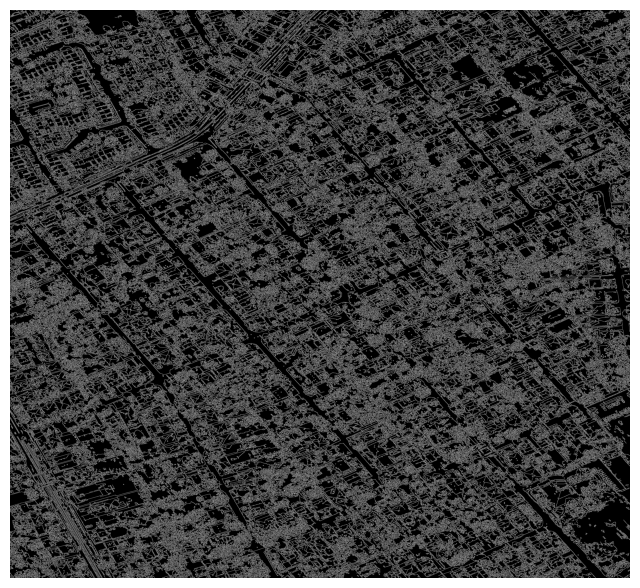

In [ ]:
def preprocess_image(image_path):
    # Load the image
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Apply a filter to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    
    # Enhance contrast with CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(blurred)
    
    return image, enhanced

def detect_edges(image):
    # Edge detection using Canny
    edges = cv2.Canny(image, 50, 150)
    return edges

def segment_and_filter(image):
    # Adaptive thresholding
    thresh = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY, 11, 2)
    
    # Morphological processing to fill holes
    kernel = np.ones((5,5), np.uint8)
    closed = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=2)
    return closed

def extract_lines(edges):
    # Line detection using Hough Transform
    lines = cv2.HoughLinesP(edges, 1, np.pi / 180, 50, minLineLength=50, maxLineGap=20)
    return lines

def draw_detected_roads(image, lines):
    # Create an image to display detected roads
    road_map = np.zeros_like(image)
    
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            cv2.line(road_map, (x1, y1), (x2, y2), (0, 255, 0), 2)
    
    # Overlay detected roads on the original image
    final_result = cv2.addWeighted(image, 0.7, road_map, 0.3, 0)
    return final_result

def main(image_path):
    image, processed_image = preprocess_image(image_path)
    edges = detect_edges(processed_image)
    segmented = segment_and_filter(processed_image)
    lines = extract_lines(edges)
    result = draw_detected_roads(image, lines)
    
    # Display results
    plt.figure(figsize=(8, 8))
    plt.imshow(edges, cmap='gray')
    plt.axis('off')
    plt.show()

# Script usage
image_path = "../Datas/Ottawa-Dataset/20/Ottawa-20.tif"
main(image_path)

### House detection

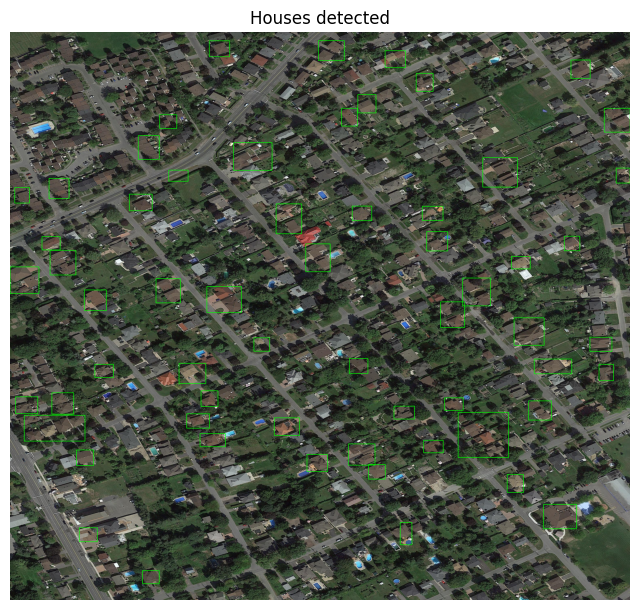

In [ ]:
# Define brown color range in HSV
lower_brown = np.array([10, 50, 20])  # Min H, S, V
upper_brown = np.array([30, 255, 200])  # Max H, S, V

# Apply a mask to extract roads
mask = cv2.inRange(image_hsv, lower_brown, upper_brown)

# Refine the mask with morphological operations
kernel = np.ones((15, 15), np.uint8)
mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

# Find contours
contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Draw detected contours on the original image
min_area = 5000
image_contours = image.copy()
for cnt in contours:
    approx = cv2.approxPolyDP(cnt, 0.01 * cv2.arcLength(cnt, True), True)
    if len(approx) >= 4:  # Check if it's a polygon with at least 4 sides
        x, y, w, h = cv2.boundingRect(approx)
        if w * h > min_area:
            cv2.rectangle(image_contours, (x, y), (x + w, y + h), (0, 255, 0), 2)

# Convert the image with contours to RGB for display
image_contours_rgb = cv2.cvtColor(image_contours, cv2.COLOR_BGR2RGB)

# Display the result
plt.figure(figsize=(8, 8))
plt.imshow(image_contours_rgb)
plt.title("Houses Detected")
plt.axis('off')
plt.show()

### Hough

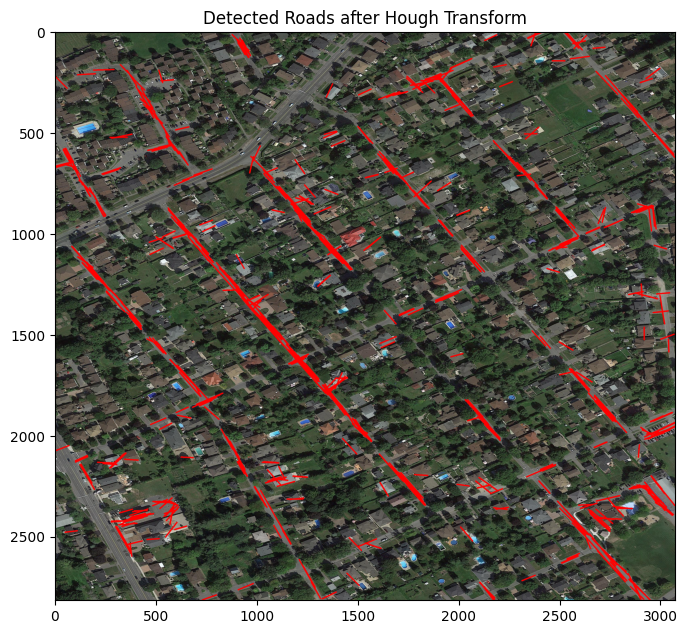

In [ ]:
lines = cv2.HoughLinesP(edges, 1, np.pi/360, threshold=30, minLineLength=60, maxLineGap=15) # edges
image_lines = image_rgb.copy()

if lines is not None:
	for line in lines:
		x1, y1, x2, y2 = line[0]
		cv2.line(image_lines, (x1, y1), (x2, y2), (255, 0, 0), 5)

plt.figure(figsize=(8,8))
plt.imshow(image_lines)
plt.title("Detected Roads after Hough Transform")
plt.axis('on')
plt.show()

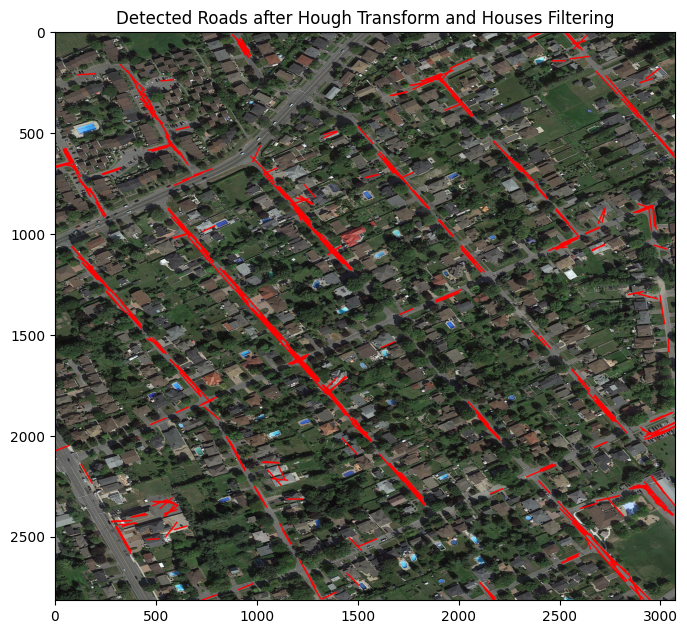

In [ ]:
# Apply Hough Line Transform
lines = cv2.HoughLinesP(edges_with, 1, np.pi/360, threshold=30, minLineLength=60, maxLineGap=15)
image_lines = image_rgb.copy()

if lines is not None:
    filtered_lines = []
    for line in lines:
        x1, y1, x2, y2 = line[0]

        # Check if the endpoints of the lines are outside the masked areas (value == 0 in mask_closed)
        out_of_mask_1 = mask_closed[y1, x1] != 0
        out_of_mask_2 = mask_closed[y2, x2] != 0

        # Keep only the lines where both endpoints are NOT in the masked area
        if out_of_mask_1 and out_of_mask_2:
            filtered_lines.append(line)
            cv2.line(image_lines, (x1, y1), (x2, y2), (255, 0, 0), 5)  # Red (BGR)

# Display the result
plt.figure(figsize=(8, 8))
plt.imshow(image_lines)
plt.title("Detected Roads after Hough Transform and Houses Filtering")
plt.axis('on')
plt.show()


In [50]:
with open('filtered_lines.txt', 'w') as f:
	for line in filtered_lines:
		x1, y1, x2, y2 = line[0]
		f.write(f"{x1},{y1},{x2},{y2}\n")

### Gabor Filter

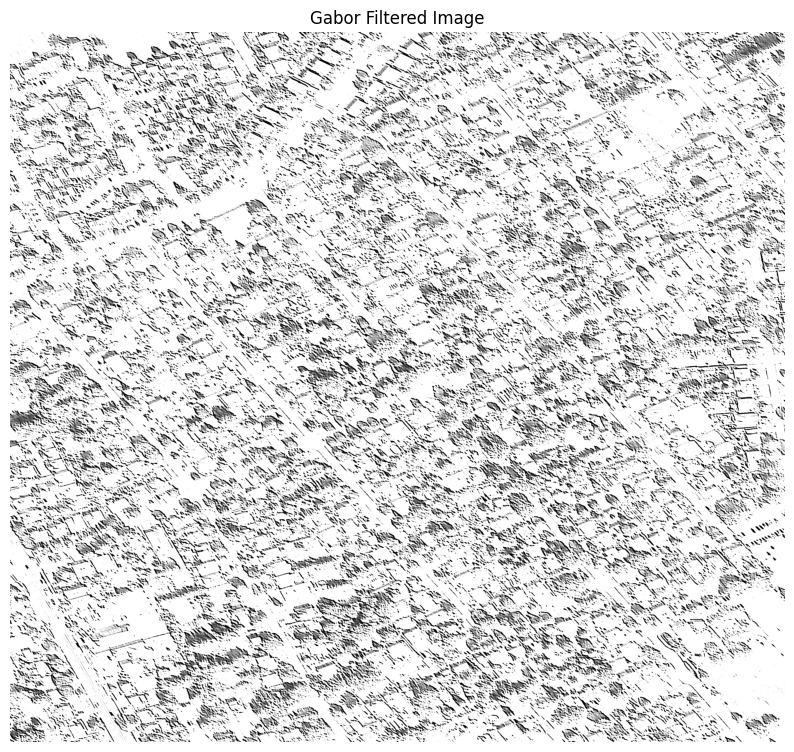

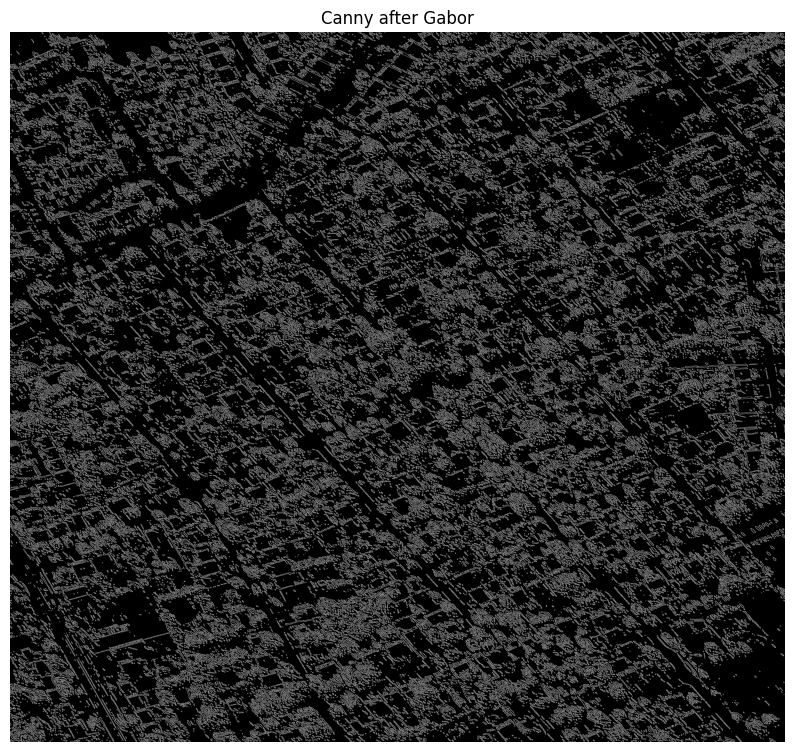

In [ ]:
def apply_gabor_filter(image, ksize=11, sigma=4, theta=np.pi/4, lambd=10, gamma=1.5, psi=0):
    gabor_kernel = cv2.getGaborKernel((ksize, ksize), sigma, theta, lambd, gamma, psi, ktype=cv2.CV_32F)
    filtered_img = cv2.filter2D(image, cv2.CV_8UC3, gabor_kernel)
    
    return filtered_img

# Convert the image to grayscale if it is not already
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply the Gabor filter before edge detection
gabor_filtered = apply_gabor_filter(gray, theta=3*np.pi/4)  # Detecting vertical structures

# Display the Gabor-filtered image
plt.figure(figsize=(10, 10))
plt.imshow(gabor_filtered, cmap='gray')
plt.title("Gabor Filtered Image")
plt.axis('off')
plt.show()

# Apply Canny edge detection after Gabor filtering
edges_gabor = cv2.Canny(gabor_filtered, 84, 255)

# Display the edges detected after Gabor filtering
plt.figure(figsize=(10, 10))
plt.imshow(edges_gabor, cmap='gray')
plt.title("Canny after Gabor")
plt.axis('off')
plt.show()